## Plot the visualizations from the script

In [20]:
import numpy as np
import pandas as pd
import scanpy as sc
from plotnine import *
import plotly.express as px
import plotly.graph_objects as go

import os
import string

### Load the output adata

In [2]:
ad = sc.read_h5ad("/p/project1/hai_fzj_bda/koenig8/ot/visualize_alpha/output_normal/adata_out.h5py")
ad

/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/anndata/_core/anndata.py:1756: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


AnnData object with n_obs × n_vars = 50000 × 1536
    obs: 'patch_id', 'brain_area', 'patchsize', 'x_st', 'y_st', 'z_st', 'brain_section_label', 'section', 'test_set', 'val_set', 'train_set', 'image_id', 'center_ccf', 'pixel_coord', 'distance', 'nearest_ST', 'nearest_cell_id', 'target_atlas_plate', 'distance_new', 'x', 'y', 'z', 'image_nr', 'group', 'slice', 'in_sample', 'batch'
    uns: 'brain_area_scores', 'brain_area_target_f1', 'neighbors', 'translation_scores', 'umap'
    obsm: '0.010_umap', '0.062_umap', '0.113_umap', '0.165_umap', '0.216_umap', '0.268_umap', '0.319_umap', '0.371_umap', '0.423_umap', '0.474_umap', '0.526_umap', '0.577_umap', '0.629_umap', '0.681_umap', '0.732_umap', '0.784_umap', '0.835_umap', '0.887_umap', '0.938_umap', '0.990_umap', 'X_translated', 'X_umap', 'brain_area_onehot', 'brain_area_similarities', 'pca_embedding', 'pca_plus_slides', 'pca_plus_slides_scaled', 'uni_embedding', 'uni_pca_95', 'uni_pca_plus_coords'
    obsp: 'connectivities', 'distances'

### Check how many alphas were tested

In [3]:
ad.uns["brain_area_scores"]

{'0.371': np.float64(0.7686952166749568),
 '0.423': np.float64(0.7685997958594111),
 '0.474': np.float64(0.7685930619275381),
 '0.526': np.float64(0.7678480952223214),
 '0.577': np.float64(0.7678570855286857),
 '0.629': np.float64(0.7678041687345725),
 '0.681': np.float64(0.7679382445157878),
 '0.732': np.float64(0.7680754757310051),
 '0.784': np.float64(0.7690824093004801),
 '0.835': np.float64(0.7680455926432248),
 '0.887': np.float64(0.7611596911812841),
 '0.938': np.float64(0.7279967813842757),
 '0.990': np.float64(0.5993840703206444)}

In [4]:
ad.uns["translation_scores"]

{'0.371': np.float64(0.0954179745249365),
 '0.423': np.float64(0.0954727195965086),
 '0.474': np.float64(0.09551870988370559),
 '0.526': np.float64(0.09412975967215731),
 '0.577': np.float64(0.09416849108774221),
 '0.629': np.float64(0.09421772982800362),
 '0.681': np.float64(0.09435335446033662),
 '0.732': np.float64(0.09482925615945818),
 '0.784': np.float64(0.09598560450738243),
 '0.835': np.float64(0.09600662495397154),
 '0.887': np.float64(0.0986853892277935),
 '0.938': np.float64(0.10233298731329554),
 '0.990': np.float64(0.09149976564054985)}

In [5]:
ad.uns["brain_area_target_f1"]

np.float64(0.7936503238758195)

## Plot the UMAP via plotly 

In [6]:
umap_keys = [k for k in ad.obsm.keys() if '0.' in k]
umap_frames = [
    pd.DataFrame(ad.obsm[k], columns = ("UMAP1", "UMAP2"))
    .assign(modality = ad.obs["batch"].to_numpy())
    .assign(alpha = float(k.split("_")[0]))
    .assign(brain_area = ad.obs["brain_area"].to_numpy())
    for k in umap_keys]
df = pd.concat(umap_frames)
df.head()

,UMAP1,UMAP2,modality,alpha,brain_area
0,-5.158267,6.028345,ST (translated),0.01,ventricle
1,16.278948,17.555719,ST (translated),0.01,Isocortex
2,15.520463,13.514055,ST (translated),0.01,Isocortex
3,11.450160,20.178793,ST (translated),0.01,Isocortex
4,14.106839,19.668907,ST (translated),0.01,Isocortex


In [7]:
df.modality.unique()

array(['ST (translated)', 'Histo'], dtype=object)

In [13]:
np.random.seed(42)
n = len(df)

available_alphas = sorted(df['alpha'].unique())

# Set up initial figure
fig = go.Figure()

# Create one scatter trace for each alpha value
for alpha_val in available_alphas:
    subset = df[df['alpha'] == alpha_val]
    scatter = go.Scatter(
        x=subset['UMAP1'], 
        y=subset['UMAP2'], 
        mode='markers',
        opacity=0.5,
        marker=dict(color=subset['modality'].map({'ST (translated)': 'purple', 'Histo': 'orange'}), size=2),
        name=f'alpha={alpha_val}',
        visible=(alpha_val == available_alphas[0])  # only first visible
    )
    fig.add_trace(scatter)

# Create steps for the slider
steps = []
for i, alpha_val in enumerate(available_alphas):
    step = dict(
        method="update",
        args=[{"visible": [j == i for j in range(len(available_alphas))]},
              {"title": f"alpha = {alpha_val}"}],
        label=str(alpha_val)
    )
    steps.append(step)

# Configure the slider
sliders = [dict(
    active=0,
    currentvalue={"prefix": "alpha: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders,
    xaxis_title='UMAP1',
    yaxis_title='UMAP2',
    title="UMAP of translated ST and native Histology samples",
    height=400,  
    width=600,   
)

fig.show()

In [14]:
fig.write_html("/p/project1/hai_fzj_bda/koenig8/ot/visualize_alpha/output_normal/plot.html")

### Plot the UMAPs via plotnine

In [8]:
df.head()

,UMAP1,UMAP2,modality,alpha,brain_area
0,-5.158267,6.028345,ST (translated),0.01,ventricle
1,16.278948,17.555719,ST (translated),0.01,Isocortex
2,15.520463,13.514055,ST (translated),0.01,Isocortex
3,11.450160,20.178793,ST (translated),0.01,Isocortex
4,14.106839,19.668907,ST (translated),0.01,Isocortex


/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.py:615: PlotnineWarning: Saving 8 x 4 in image.
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.py:616: PlotnineWarning: Filename: /p/project1/hai_fzj_bda/koenig8/ot/visualize_alpha/plt9_plots/plota.png
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.py:615: PlotnineWarning: Saving 8 x 4 in image.
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.py:616: PlotnineWarning: Filename: /p/project1/hai_fzj_bda/koenig8/ot/visualize_alpha/plt9_plots/plotb.png
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.py:615: PlotnineWarning: Saving 8 x 4 in image.
/p/project1/hai_fzj_bda/koenig8/jupyter/kernels/opt_transport/lib/python3.10/site-packages/plotnine/ggplot.

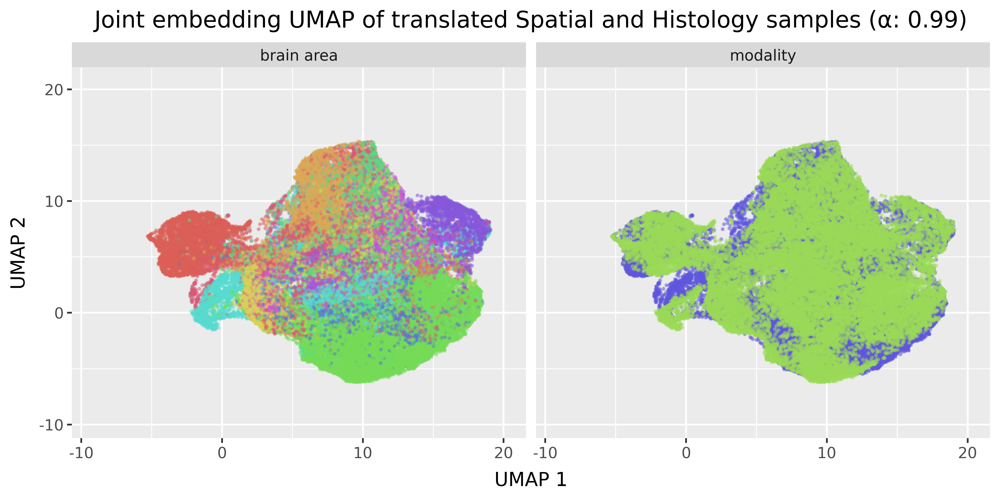

In [25]:
available_alphas = sorted(df['alpha'].unique())
x_lims = df.UMAP1.min(), df.UMAP1.max()
y_lims = df.UMAP2.min(), df.UMAP2.max()
path = "/p/project1/hai_fzj_bda/koenig8/ot/visualize_alpha/plt9_plots"


letters = list('abcdefghijklmnopqrstuvwxyz')
counter = 0
for alpha in available_alphas:
    df_plot = df[df.alpha == alpha]
    df_plot = pd.concat((df_plot.assign(color = df_plot.modality).assign(facet = "modality"),
                         df_plot.assign(color = df_plot.brain_area).assign(facet = "brain area")))
    plot = (
        ggplot(df_plot, aes(x = "UMAP1", y = "UMAP2", color="color")) +
        geom_point(size=0.3, alpha = 0.4, show_legend = False) +
        facet_wrap("~ facet") +
        labs(x="UMAP 1", y="UMAP 2", 
             title=f"Joint embedding UMAP of translated Spatial and Histology samples (α: {alpha:.2f})"
             ) +
        theme(figure_size = (8,4), dpi = 300) +
        scale_x_continuous(limits = x_lims) + 
        scale_y_continuous(limits = y_lims)
    )
    plot.save(os.path.join(path, f"plot{letters[counter]}.png"))
    counter += 1

plot

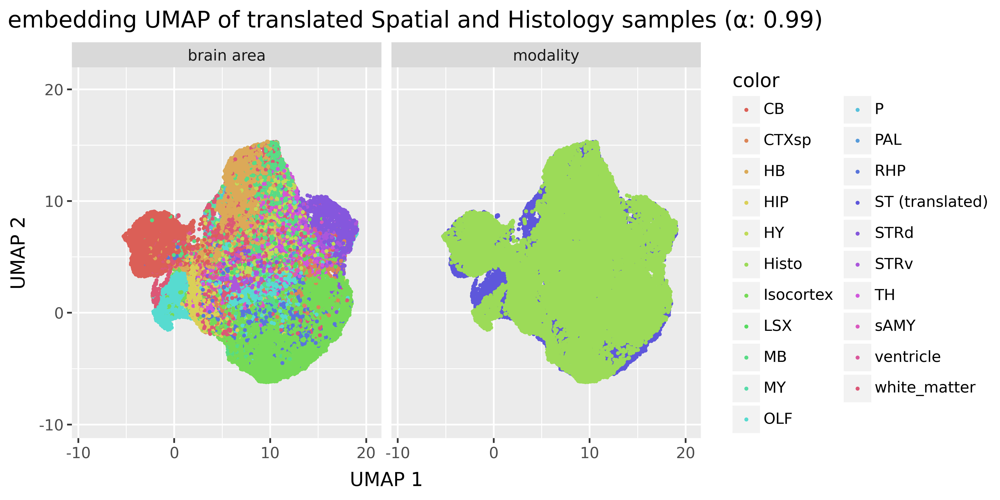

In [28]:
plot = (
        ggplot(df_plot, aes(x = "UMAP1", y = "UMAP2", color="color")) +
        geom_point(size=0.3, alpha = 1, show_legend = True) +
        facet_wrap("~ facet") +
        labs(x="UMAP 1", y="UMAP 2", 
             title=f"Joint embedding UMAP of translated Spatial and Histology samples (α: {alpha:.2f})"
             ) +
        theme(figure_size = (8,4), dpi = 300) +
        scale_x_continuous(limits = x_lims) + 
        scale_y_continuous(limits = y_lims)
    )
plot